In [1]:
proj_name = 'MINDLAB2020_MEG-AuditoryPatternRecognition'
wdir = '/projects/' + proj_name + '/scratch/working_memory/'
scripts_dir = '/projects/' + proj_name + '/scripts/working_memory/'
import sys
sys.path.append(scripts_dir)

import mne
from mne.time_frequency import tfr_morlet, csd_morlet
import os
import os.path as op
import numpy as np
import pickle
from warnings import filterwarnings
from sys import argv
import matplotlib.pyplot as plt
from stormdb.access import Query
import pandas as pd
from src.preprocessing import WM_epoching, main_task_events_fun, default_events_fun
from src.decoding_functions import smooth_data

filterwarnings("ignore", category=DeprecationWarning)



In [2]:

project = 'MINDLAB2020_MEG-AuditoryPatternRecognition'
project_dir = '/projects/' + project
os.environ['MINDLABPROJ']= project
os.environ['MNE_ROOT']='/users/david/miniconda3/envs/mne' # for surfer
os.environ['MESA_GL_VERSION_OVERRIDE'] = '3.2'

raw_path = project_dir + '/scratch/maxfiltered_data/tsss_st16_corr96'
ica_path = project_dir + '/scratch/working_memory/ICA'
avg_path = project_dir + '/scratch/working_memory/averages'
log_path = project_dir + '/misc/working_memory_logs'

subjects_dir = project_dir + '/scratch/fs_subjects_dir'
fwd_path = project_dir + '/scratch/forward_models'

qy = Query(project)
subs = qy.get_subjects()

scode = 48
# if len(argv) > 1:
#     scode = int(argv[1])


In [3]:
sub = subs[scode-1] 
conds_orig = ['main','inv']
conds = ['maintenance','manipulation']
lnames = ['recognize','invert']
save_averages = True
plot_topo = True
compute_sources = True
smooth_tstep = 0.025
smooth_twin = 0.05
l_freq=.05
h_freq=None

suffix = "lf_{}_hf_{}_tstep_{}_twin_{}".format(l_freq,h_freq,smooth_tstep, smooth_twin)


In [4]:
epochs = {}
evokeds = {}

print('\n epoching \n')
## Alternative epoching strategy
tmin = -1.5
tmax = 6
reject = dict(mag = 4e-12, grad = 4000e-13)
epochs = {}
evokeds = {}
print('\n epoching \n')
for cidx, c in enumerate(conds_orig):
    nc = conds[cidx]
    fname = os.path.join(raw_path, sub, c + '_raw_tsss.fif')
    icaname = os.path.join(ica_path,sub, c + '_raw_tsss-ica.fif')
    lfname = op.join(log_path, sub[0:4] + '_' + lnames[cidx] + '_MEG.csv')
    epochs[nc] = WM_epoching(data_path=fname, ica_path=icaname, tmin=tmin, tmax=tmax,
                                l_freq=l_freq, h_freq=h_freq, resample = 300, bads=[],
                                baseline=None, notch_filter=50,
                                events_fun=main_task_events_fun, events_fun_kwargs = {'cond': nc, 'lfname': lfname},
                                reject=reject)

epochs = mne.concatenate_epochs([epochs[e] for e in epochs])
print(epochs)



 epoching 


 epoching 

Opening raw data file /projects/MINDLAB2020_MEG-AuditoryPatternRecognition/scratch/maxfiltered_data/tsss_st16_corr96/0048_7BH/main_raw_tsss.fif...
    Range : 8000 ... 579999 =      8.000 ...   579.999 secs
Ready.
Reading 0 ... 571999  =      0.000 ...   571.999 secs...
Reading /projects/MINDLAB2020_MEG-AuditoryPatternRecognition/scratch/working_memory/ICA/0048_7BH/main_raw_tsss-ica.fif ...
Now restoring ICA solution ...
Ready.
Applying ICA to Raw instance
    Transforming to ICA space (24 components)
    Zeroing out 2 ICA components
    Projecting back using 306 PCA components
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passba

In [5]:
#all_epochs = mne.epochs.concatenate_epochs([epochs[c] for c in epochs])
freqs = np.concatenate([np.arange(1,14,1),np.arange(15,30,2),np.arange(30,60,5),np.arange(60,150,10)])
#freqs = np.logspace(*np.log10([2,100]),20)
n_cycles = freqs/2.
power = tfr_morlet(epochs, freqs = freqs, n_cycles= n_cycles,
                           use_fft = True,return_itc = False, decim = 15,
                           average = False, n_jobs=4)

[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done  68 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:   18.7s
[Parallel(n_jobs=4)]: Done 306 out of 306 | elapsed:   21.8s finished


Not setting metadata


In [6]:
baseline = [-1,0.]
bix = (power.times >= baseline[0]) & (power.times < baseline[1]) 
bmean = np.mean(power.data[...,bix],axis=(0,3),keepdims=True)
bsd = np.std(power.data[...,bix],axis=(0,3),keepdims=True)
power.data -= bmean
power.data /= bsd
bmean2 = np.mean(power.data[...,bix],axis=(3),keepdims=True)
power.data -= bmean2

In [7]:
bmean.shape

(1, 306, 36, 1)

In [8]:
plt.close('all')

In [9]:
pdiff = power['manipulation'].average().copy().__sub__(power['maintenance'].average())

In [10]:
inv_mdiff = power['manipulation/mel2'].average().copy().__sub__(power['manipulation/mel1'].average())

In [11]:
main_mdiff = power['maintenance/mel2'].average().copy().__sub__(power['maintenance/mel1'].average())

In [12]:
inter = inv_mdiff.copy().__sub__(main_mdiff)

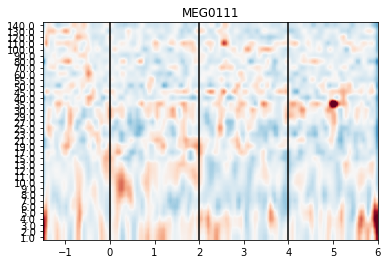

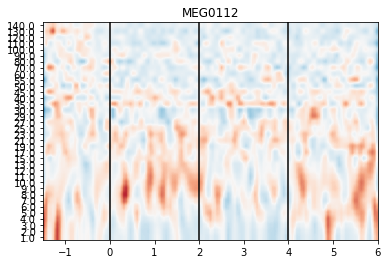

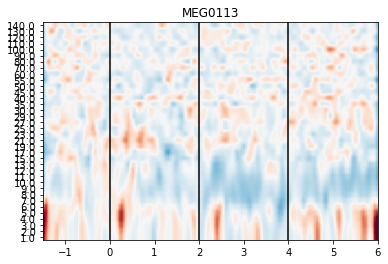

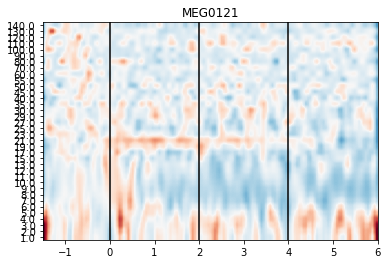

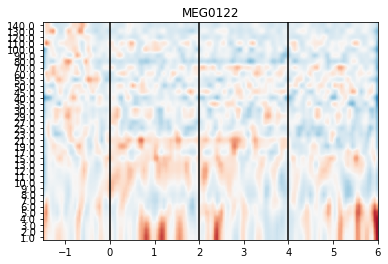

...

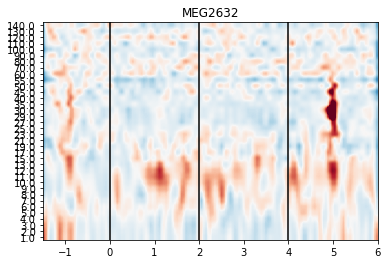

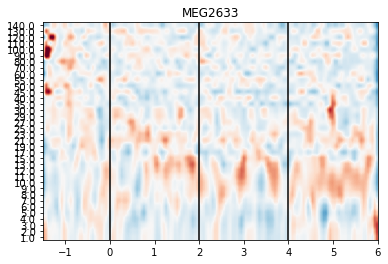

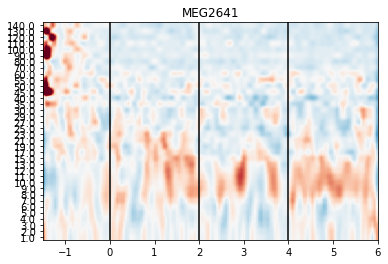

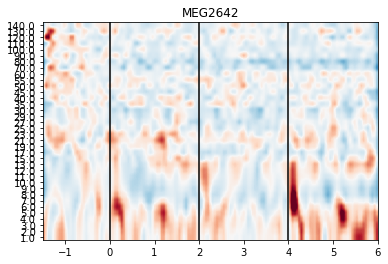

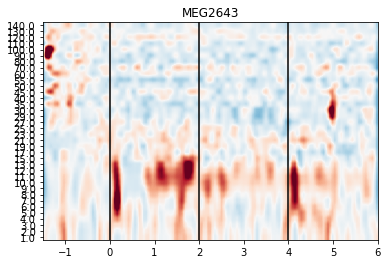

In [13]:
ccond = 'manipulation'
ch_names = power.info['ch_names']
ncols = 5
nrows = len(ch_names)//ncols + 1
#figure = plt.figure(figsize=(ncols*3,nrows*3))
pcount = 0 
for chix,ch in enumerate(ch_names):
    pcount += 1
    ch_data = power[ccond].average().data[chix]
    figure,cax = plt.subplots(ncols=1,nrows=1)
    #cax = plt.subplot(nrows,ncols,pcount)
    cax.imshow(ch_data, origin='lower', extent = [power.times[0],power.times[-1],0,len(power.freqs)],
               aspect='auto', vmin=-1,vmax=1, cmap = 'RdBu_r')
    cax.set_title(ch)
    cax.set_yticks(np.arange(len(power.freqs))+.5)
    cax.set_yticklabels(power.freqs)
    cax.axvline(0,color='k')
    cax.axvline(2,color='k')
    cax.axvline(4,color='k')
    plt.show()
#plt.tight_layout()
#plt.show()
plt.close('all')

In [ ]:
ccond = 'maintenance'
ch_names = power.info['ch_names']
ncols = 5
nrows = len(ch_names)//ncols + 1
#figure = plt.figure(figsize=(ncols*3,nrows*3))
pcount = 0 
for chix,ch in enumerate(ch_names):
    pcount += 1
    ch_data = power.average().data[chix]
    figure,cax = plt.subplots(ncols=1,nrows=1)
    #cax = plt.subplot(nrows,ncols,pcount)
    cax.imshow(ch_data, origin='lower', extent = [power.times[0],power.times[-1],0,len(power.freqs)],
               aspect='auto', vmin=-1,vmax=1, cmap = 'RdBu_r')
    cax.set_title(ch)
    cax.set_yticks(np.arange(len(power.freqs))+.5)
    cax.set_yticklabels(power.freqs)
    cax.axvline(0,color='k')
    cax.axvline(2,color='k')
    cax.axvline(4,color='k')
    plt.show()
#plt.tight_layout()
#plt.show()
plt.close('all')

In [ ]:
cchix = np.where(np.array(ch_names) == 'MEG0111')[0]
ntrials = epochs.get_data().shape[0]
ccond = 'manipulation'
ncols = 1
nrows = ntrials//ncols + 1
figure = plt.figure(figsize=(14,nrows*3))
pcount = 0 
for trix in range(ntrials):
    pcount += 1
    tr_data = epochs.get_data()[trix,chix]
    cax = plt.subplot(nrows,ncols,pcount)
    cax.plot(epochs.times,tr_data,color='k')
    cax.set_xlim(1,3)#epochs.times[0],epochs.times[-1])
    cax.set_title(f'trial {trix+1}')
    cax.axvline(0,color='k',alpha=.6)
    cax.axvline(2,color='k',alpha=.6)
    cax.axvline(4,color='k',alpha=.6)
plt.tight_layout()

In [ ]:
#fig,ax=plt.subplots(nrows=1,ncols=1,figsize=(10,10))
pdiff.plot_topomap(fmin=70,fmax=140,ch_type='grad')

In [ ]:
power['manipulation'].average().plot_topomap(fmin=70,fmax=140,ch_type='grad')

In [ ]:
power['maintenance'].average().plot_topomap(fmin=70,fmax=140,ch_type='grad')

In [ ]:
pdiff.plot_joint()

In [ ]:
power.average().plot_joint()

No baseline correction applied


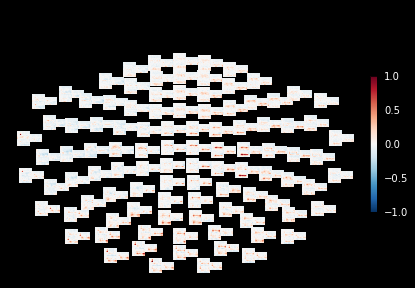

In [32]:
fig = power.average().plot_topo(vmin=-1,vmax=1)
fig.savefig(op.join(avg_path, sub + 'plot_topo_TFR_all.pdf'),dpi=600)

No baseline correction applied


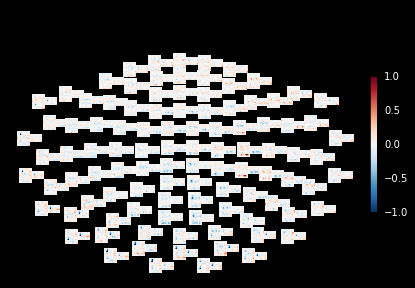

In [33]:
fig = pdiff.plot_topo(vmin=-1,vmax=1)
fig.savefig(op.join(avg_path, sub + 'plot_topo_TFR_diff.pdf'),dpi=600)

No baseline correction applied


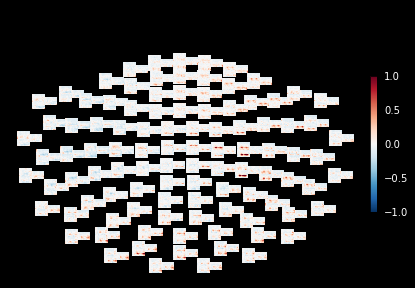

In [34]:
fig = power['manipulation'].average().plot_topo(vmin=-1,vmax=1)
fig.savefig(op.join(avg_path, sub + 'plot_topo_TFR_manip.pdf'),dpi=600)

No baseline correction applied


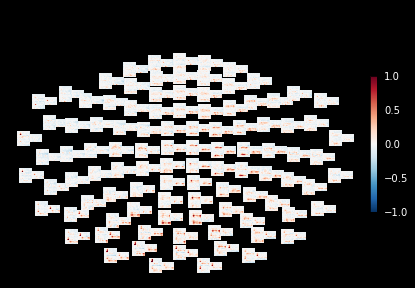

In [35]:
fig = power['maintenance'].average().plot_topo(vmin=-1,vmax=1)
fig.savefig(op.join(avg_path, sub + 'plot_topo_TFR_maint.pdf'),dpi=600)

In [ ]:
#ccond = 'maintenance'
ch_names = power.info['ch_names']
ncols = 5
nrows = len(ch_names)//ncols + 1
figure = plt.figure(figsize=(ncols*3,nrows*4))
pcount = 0 
for chix,ch in enumerate(ch_names):
    pcount += 1
    ch_data =pdiff.data[chix]
    cax = plt.subplot(nrows,ncols,pcount)
    cax.imshow(ch_data, origin='lower', extent = [power.times[0],power.times[-1],0,len(power.freqs)],
               aspect='auto', vmin=-1,vmax=1, cmap='RdBu_r')
    cax.set_title(ch)
    cax.set_yticks(np.arange(len(power.freqs))+.5)
    cax.set_yticklabels(power.freqs)
    cax.axvline(0,color='k')
    cax.axvline(2,color='k')
    cax.axvline(4,color='k')
plt.tight_layout()
plt.show()

In [ ]:
#ccond = 'maintenance'
ch_names = power.info['ch_names']
ncols = 5
nrows = len(ch_names)//ncols + 1
figure = plt.figure(figsize=(ncols*3,nrows*3))
pcount = 0 
for chix,ch in enumerate(ch_names):
    pcount += 1
    ch_data =inv_mdiff.data[chix]
    cax = plt.subplot(nrows,ncols,pcount)
    cax.imshow(ch_data, origin='lower', extent = [power.times[0],power.times[-1],0,len(power.freqs)],
               aspect='auto', vmin=-1,vmax=1, cmap='RdBu_r')
    cax.set_title(ch)
    cax.set_yticks(np.arange(len(power.freqs))+.5)
    cax.set_yticklabels(power.freqs)
    cax.axvline(0,color='k')
    cax.axvline(2,color='k')
    cax.axvline(4,color='k')
plt.tight_layout()
plt.show()

In [ ]:
#ccond = 'maintenance'
ch_names = power.info['ch_names']
ncols = 5
nrows = len(ch_names)//ncols + 1
figure = plt.figure(figsize=(ncols*3,nrows*3))
pcount = 0 
for chix,ch in enumerate(ch_names):
    pcount += 1
    ch_data =main_mdiff.data[chix]
    cax = plt.subplot(nrows,ncols,pcount)
    cax.imshow(ch_data, origin='lower', extent = [power.times[0],power.times[-1],0,len(power.freqs)],
               aspect='auto', vmin=-1,vmax=1, cmap='RdBu_r')
    cax.set_title(ch)
    cax.set_yticks(np.arange(len(power.freqs))+.5)
    cax.set_yticklabels(power.freqs)
    cax.axvline(0,color='k')
    cax.axvline(2,color='k')
    cax.axvline(4,color='k')
plt.tight_layout()
plt.show()

In [ ]:
ch_names = power.info['ch_names']
ncols = 5
nrows = len(ch_names)//ncols + 1
figure = plt.figure(figsize=(ncols*3,nrows*3))
pcount = 0 
for chix,ch in enumerate(ch_names):
    pcount += 1
    ch_data =inter.data[chix]
    cax = plt.subplot(nrows,ncols,pcount)
    cax.imshow(ch_data, origin='lower', extent = [power.times[0],power.times[-1],0,len(power.freqs)],
               aspect='auto', vmin=-1,vmax=1, cmap='RdBu_r')
    cax.set_title(ch)
    cax.set_yticks(np.arange(len(power.freqs))+.5)
    cax.set_yticklabels(power.freqs)
    cax.axvline(0,color='k')
    cax.axvline(2,color='k')
    cax.axvline(4,color='k')
plt.tight_layout()
plt.show()

No baseline correction applied


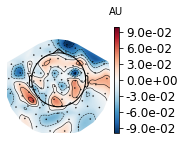

In [18]:
fig=inv_mdiff.plot_topomap(fmin=70,fmax=140,tmin=1,tmax=2.5,ch_type='grad')

No baseline correction applied


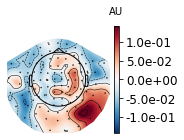

In [19]:
fig=main_mdiff.plot_topomap(fmin=70,fmax=140,tmin=1,tmax=2.5,ch_type='grad')

No baseline correction applied


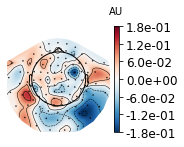

In [20]:
fig = inter.plot_topomap(fmin=70,fmax=140,tmin=1,tmax=2.5,ch_type='grad')

No baseline correction applied


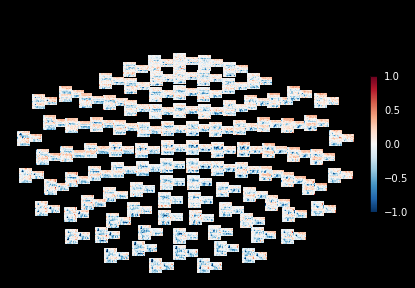

In [36]:
fig = inter.plot_topo(vmin=-1,vmax=1)
fig.savefig(op.join(avg_path, sub + 'plot_topo_TFR_inter.pdf'),dpi=600)

In [ ]:
power.average().plot(vmin=-.8,vmax=.8,title='auto')

In [ ]:
plt.close('all')